# Setup

In [22]:
import numpy as np
import pandas as pd
import json
import scanpy as sc
import os
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib as mpl
import scvi
import scrnatools as rna
from matplotlib.patches import Patch
import anndata as ad

In [2]:
sc.set_figure_params(figsize=(6,6), dpi=80, dpi_save=300, facecolor="white", frameon=False)
sns.set_context("notebook")
plt.rcParams["axes.grid"] = False
rna.configs.verbosity = "info"

# Load data

In [3]:
%%time
# Read in the kallisto bustools output for each sample. Requires the path and file name for the mtx/barcodes/ec files
# Returns an AnnData containing the ec counts and the ec id's
path = "/notebook/External/Archive/Joe/raw_data/Corey_thymus/CE_kallisto_alignment/counts_unfiltered/cells_x_tcc"
adataCoreyWT, ecCoreyWT = rna.tl.read_kallisto_tcc_matrix(path)
    
path = "/notebook/External/Archive/Joe/raw_data/Yi_thymus/WT_kallisto_alignment/counts_unfiltered/cells_x_tcc"
adataYiWT, ecYiWT = rna.tl.read_kallisto_tcc_matrix(path)

path = "/notebook/External/Archive/Joe/raw_data/Yi_thymus/KO_kallisto_alignment/counts_unfiltered/cells_x_tcc"
adataYiKO, ecYiKO = rna.tl.read_kallisto_tcc_matrix(path)

2022-09-07 22:39:52 - read_kallisto_tcc_matrix - INFO: Reading sample: /notebook/External/Archive/Joe/raw_data/Corey_thymus/CE_kallisto_alignment/counts_unfiltered/cells_x_tcc
2022-09-07 22:41:38 - read_kallisto_tcc_matrix - INFO: Reading sample: /notebook/External/Archive/Joe/raw_data/Yi_thymus/WT_kallisto_alignment/counts_unfiltered/cells_x_tcc
2022-09-07 22:43:14 - read_kallisto_tcc_matrix - INFO: Reading sample: /notebook/External/Archive/Joe/raw_data/Yi_thymus/KO_kallisto_alignment/counts_unfiltered/cells_x_tcc


CPU times: user 3min 42s, sys: 7.9 s, total: 3min 50s
Wall time: 4min 54s


# Preprocessing

In [4]:
# Prefilter any cells with no ec's, ec's with no cells, and transfer ec id's to adata.var_names for each sample
print(f"Corey WT")
rna.tl.isoform_preprocessing(adataCoreyWT, ecCoreyWT)
print(f"Yi WT")
rna.tl.isoform_preprocessing(adataYiWT, ecYiWT)
print(f"Yi KO")
rna.tl.isoform_preprocessing(adataYiKO, ecYiKO)

Corey WT


2022-09-07 22:44:49 - isoform_preprocessing - INFO: Filtered 205207 ecs with no counts
2022-09-07 22:44:50 - isoform_preprocessing - INFO: Filtered 1 cells with no ecs


Yi WT


2022-09-07 22:44:51 - isoform_preprocessing - INFO: Filtered 202938 ecs with no counts
2022-09-07 22:44:52 - isoform_preprocessing - INFO: Filtered 4 cells with no ecs


Yi KO


2022-09-07 22:44:54 - isoform_preprocessing - INFO: Filtered 231098 ecs with no counts
2022-09-07 22:44:55 - isoform_preprocessing - INFO: Filtered 0 cells with no ecs


# Merge samples

In [5]:
adata = ad.concat(
    {"Corey_WT": adataCoreyWT, "Yi_WT": adataYiWT, "Yi_KO": adataYiKO},
    join="outer", 
    label="batch",
    index_unique="-",
)
# Compute qc metrics
sc.pp.calculate_qc_metrics(adata, inplace=True, percent_top=None, log1p=False,)

## qc plots before filtering

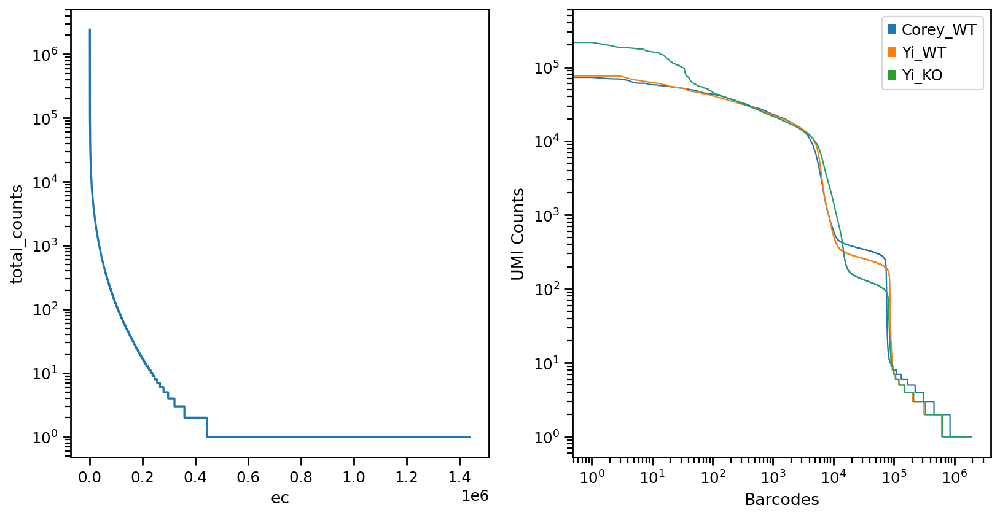

In [6]:
# Plot qc metrics for all ec's and cells
rna.pl.isoform_qc_plot(adata, batch_key="batch")

# Filter on cells from cellranger processing pipeline

In [7]:
# Read in the processed data from the cellranger gene-level scVI pipeline
geneAdata = sc.read("/notebook/External/Archive/Joe/processed_data/TSA_scoring/h5ad_files/combined_WT_KO_mTECs_expression_filtered_genes.h5ad")
geneAdata = geneAdata[geneAdata.obs.batch_key.isin(["Corey_WT_adult_sorted_mTECs", "Yi_KO_adult_sorted_mTECs", "Yi_WT_adult_sorted_mTECs"])].copy()
# Rename barccodes to match the barcodes in the isoform processing
geneAdata.obs['barcode'] = [i[0] for i in geneAdata.obs.index.str.split("-")]
geneAdata.obs['batch'] = [i[0] for i in geneAdata.obs.batch_key.str.rsplit("_", 3)]
geneAdata.obs.barcode = geneAdata.obs.barcode + "-" + geneAdata.obs.batch
geneAdata.obs.index = geneAdata.obs.barcode

In [8]:
# Filter isoform data on cells from cellranger processing
adata = adata[adata.obs.index.isin(geneAdata.obs.index)].copy()

In [9]:
# Add annotations/data from cellranger processing
adata.obs["genotype"] = geneAdata.obs.genotype
adata.obs["cell_type"] = geneAdata.obs.cell_type
adata.obsm["gene_umap"] = geneAdata.obsm["X_umap"]
adata.uns["gene_scVI_normalized"] = geneAdata.layers["scVI_normalized"]
adata.uns["gene_raw_counts"] = geneAdata.layers["raw_counts"]

In [10]:
# Recompute qc metrics
sc.pp.calculate_qc_metrics(adata, inplace=True, percent_top=None, log1p=False,)
# Filter out new no counts ec's
ngenes = adata.shape[1]
sc.pp.filter_genes(adata, min_counts=1)
print(f"Filtered {ngenes - adata.shape[1]} ecs with no counts")
# Filter out ec's with less than 0.001 counts on average
ngenes = adata.shape[1]
adata = adata[:, adata.var.mean_counts > 0.001].copy()
print(f"Filtered {ngenes - adata.shape[1]} ecs with < 0.001 mean counts")

Filtered 213111 ecs with no counts
Filtered 1059407 ecs with < 0.001 mean counts


## qc plots after filtering

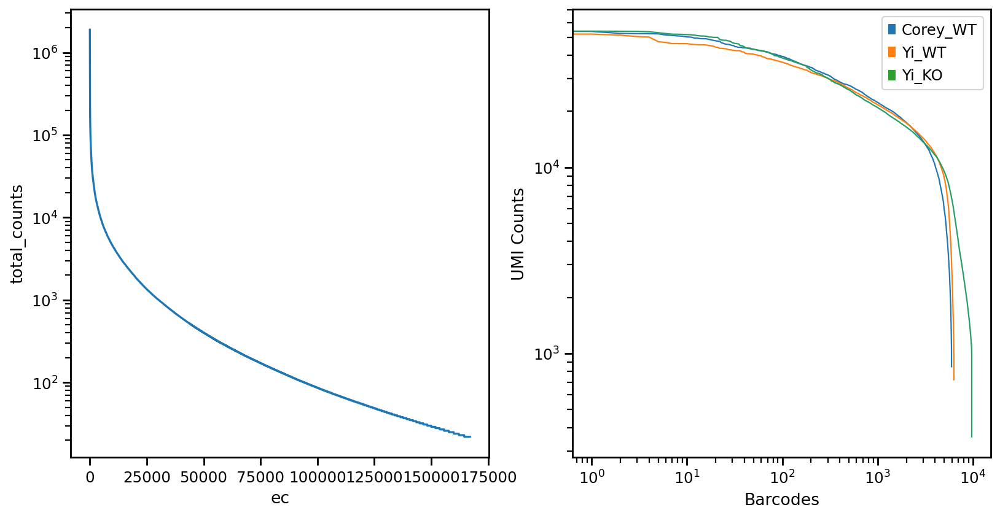

In [11]:
# Replot qc metrics for the filtered ec's and cells
rna.pl.isoform_qc_plot(adata, batch_key="batch")

In [12]:
adata

AnnData object with n_obs × n_vars = 21963 × 167022
    obs: 'n_genes', 'batch', 'n_genes_by_counts', 'total_counts', 'genotype', 'cell_type'
    var: 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_counts'
    uns: 'gene_scVI_normalized', 'gene_raw_counts'
    obsm: 'gene_umap'

# Create lookup tables

In [13]:
%%time
# Create a ec to transcript, ec to gene, and gene to ec lookup dictionary for downstream use
# Requires the kallisto transcript file from any of the samples processed and the transcripts
# to genes file of the kallisto reference used for alignment.
ec2tx, ec2g, inv_map = rna.tl.create_isoform_lookup_tables(
    adata,
    "/notebook/External/Archive/Joe/raw_data/Corey_thymus/CE_kallisto_alignment/transcripts.txt",
    "/notebook/Joe/TSA-score/mouse_transcripts_to_genes.txt",
)

2022-09-07 22:47:51 - create_isoform_lookup_tables - INFO: Number of ec errors: 5429


CPU times: user 1min 29s, sys: 1.26 s, total: 1min 30s
Wall time: 1min 29s


In [16]:
# Any transcript to gene lookup errors are stored in a dictionary in adata.uns. Any ec's with no 
# valid tx to gene mappings are given a 'None' entry in the ec2g lookup table, otherwise only
# valid tx to gene mappings are included in an ec's ec2g mapping (i.e. transcripts within an ec
# that don't have a tx to gene mapping are exluded from the ec2g entry for that ec)
len(adata.uns['key_errors'])

5429

# Save anndata

In [19]:
%%time
# Save the isoform AnnData and the lookup tables (json file identifiers are added to the provided path)
path = "/notebook/External/Archive/Joe/processed_data/TSA_scoring/h5ad_files/WT_KO_thymus_isoforms"
adata.write(f"{path}.h5ad")
rna.tl.save_isoform_lookup_tables(path, ec2tx, ec2g, inv_map)

CPU times: user 6.87 s, sys: 467 ms, total: 7.34 s
Wall time: 10.1 s


# Load lookup tables from files

In [20]:
%%time
# Load the isoform AnnData and the lookup tables (json file identifiers are added to the provided path)
path = "/notebook/External/Archive/Joe/processed_data/TSA_scoring/h5ad_files/WT_KO_thymus_isoforms"
adata = sc.read(f"{path}.h5ad")
ec2tx, ec2g, inv_map = rna.tl.load_isoform_lookup_tables(path)

CPU times: user 4.42 s, sys: 823 ms, total: 5.24 s
Wall time: 7.84 s


# scVI processing of isoform data

In [25]:
# Save a copy of the raw tcc data to a layer
adata.layers["raw_tcc"] = adata.X.copy()
# Setup the AnnData for scVI
scvi.model.SCVI.setup_anndata(
    adata,
    layer="raw_tcc",
    batch_key="batch",
)
model = scvi.model.SCVI(adata)
# Train the model
model.train()
# Save the model
model.save("/notebook/External/Archive/Joe/processed_data/TSA_scoring/scVI_models/WT_KO_thymus_isoforms")
# get scVI latent space and normalized expression
adata.obsm["TCC_scVI"] = model.get_latent_representation()
adata.layers["scvi_normalized_tcc"] = model.get_normalized_expression(library_size=10e4)
# Save the AnnData
path = "/notebook/External/Archive/Joe/processed_data/TSA_scoring/h5ad_files/WT_KO_thymus_isoforms"
adata.write(f"{path}.h5ad")

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/364:   0%|          | 0/364 [00:00<?, ?it/s]

/opt/conda/lib/python3.8/site-packages/scvi/distributions/_negative_binomial.py:61: UserWarning: Specified kernel cache directory could not be created! This disables kernel caching. Specified directory is /root/.cache/torch/kernels. This warning will appear only once per process. (Triggered internally at  /opt/conda/conda-bld/pytorch_1646755903507/work/aten/src/ATen/native/cuda/jit_utils.cpp:860.)
  + torch.lgamma(x + theta)


Epoch 364/364: 100%|██████████| 364/364 [1:35:11<00:00, 15.69s/it, loss=1.91e+04, v_num=1]


# Dimensionality reduction

In [26]:
sc.pp.neighbors(adata, use_rep="TCC_scVI")
sc.tl.umap(adata, min_dist=0.3)

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [33]:
adata

AnnData object with n_obs × n_vars = 21963 × 167022
    obs: 'n_genes', 'batch', 'n_genes_by_counts', 'total_counts', 'genotype', 'cell_type', '_scvi_batch', '_scvi_labels'
    var: 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_counts', 'ecs', 'ec_tx_error'
    uns: 'gene_raw_counts', 'gene_scVI_normalized', 'key_errors', '_scvi_uuid', '_scvi_manager_uuid', 'neighbors', 'umap', 'cell_type_colors'
    obsm: 'gene_umap', 'TCC_scVI', 'X_umap'
    layers: 'raw_tcc', 'scvi_normalized_tcc'
    obsp: 'distances', 'connectivities'

In [46]:
inv_map["Aire"]

{'31233': ['ENSMUST00000162293.7',
  'ENSMUST00000145975.7',
  'ENSMUST00000130972.7',
  'ENSMUST00000128241.7',
  'ENSMUST00000143548.7',
  'ENSMUST00000131028.7',
  'ENSMUST00000155021.7',
  'ENSMUST00000140636.7',
  'ENSMUST00000148469.7',
  'ENSMUST00000019257.14',
  'ENSMUST00000105395.8',
  'ENSMUST00000156417.7',
  'ENSMUST00000105396.8',
  'ENSMUST00000143735.7',
  'ENSMUST00000154374.1'],
 '131110': ['ENSMUST00000145975.7',
  'ENSMUST00000130972.7',
  'ENSMUST00000128241.7'],
 '131111': ['ENSMUST00000145975.7',
  'ENSMUST00000130972.7',
  'ENSMUST00000128241.7',
  'ENSMUST00000143548.7',
  'ENSMUST00000131028.7'],
 '131112': ['ENSMUST00000145975.7',
  'ENSMUST00000130972.7',
  'ENSMUST00000128241.7',
  'ENSMUST00000143548.7',
  'ENSMUST00000131028.7',
  'ENSMUST00000155021.7',
  'ENSMUST00000140636.7',
  'ENSMUST00000148469.7',
  'ENSMUST00000019257.14',
  'ENSMUST00000105395.8',
  'ENSMUST00000156417.7',
  'ENSMUST00000105396.8'],
 '131113': ['ENSMUST00000145975.7',
  'ENSMUS

In [47]:
Aire_single_ecs = ["131173", "131269", "131309"]

In [36]:
Aire_ecs = list(inv_map["Aire"].keys())
Aire_ecs

['31233',
 '131110',
 '131111',
 '131112',
 '131113',
 '131114',
 '131115',
 '131116',
 '131117',
 '131118',
 '131119',
 '131120',
 '131121',
 '131122',
 '131123',
 '131124',
 '131125',
 '131126',
 '131127',
 '131134',
 '131153',
 '131154',
 '131158',
 '131173',
 '131174',
 '131175',
 '131176',
 '131192',
 '131269',
 '131309']

In [38]:
[ec2g[i] for i in Aire_ecs]

[['Aire', 'Grip2'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire', 'Prnp'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire', 'Lingo4', 'Mthfs', 'Trim2', 'Uvrag'],
 ['Aire', 'Aqr', 'Fto', 'Nphs1'],
 ['Aire', 'Uvrag'],
 ['Aire'],
 ['Aire'],
 ['Aire']]

## UMAP comparison

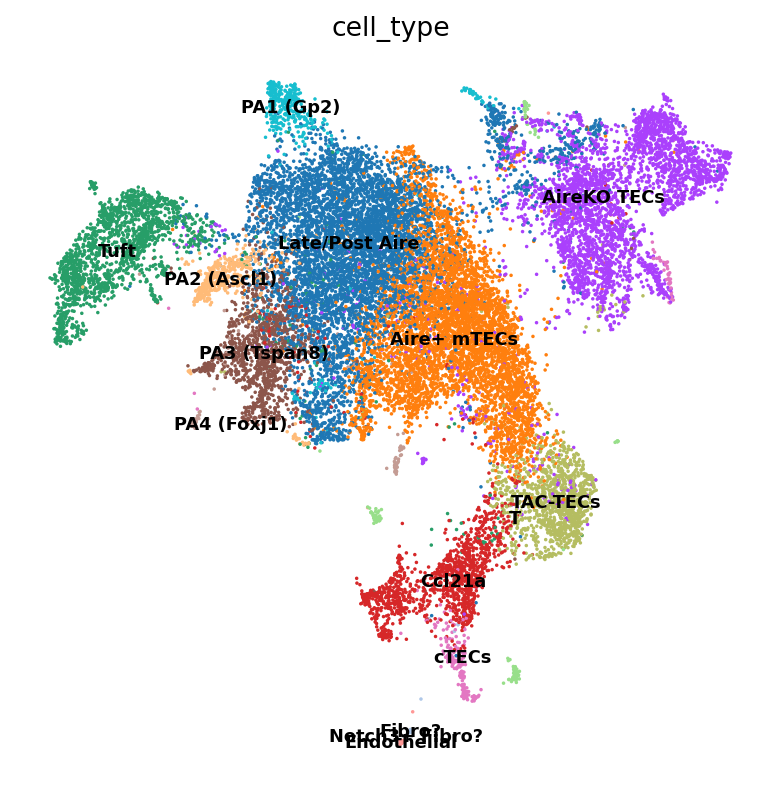

In [31]:
# isoform
sc.pl.umap(
    adata,
    color=["cell_type"],
    legend_loc="on data",
    s=10,
    legend_fontsize=8,
)

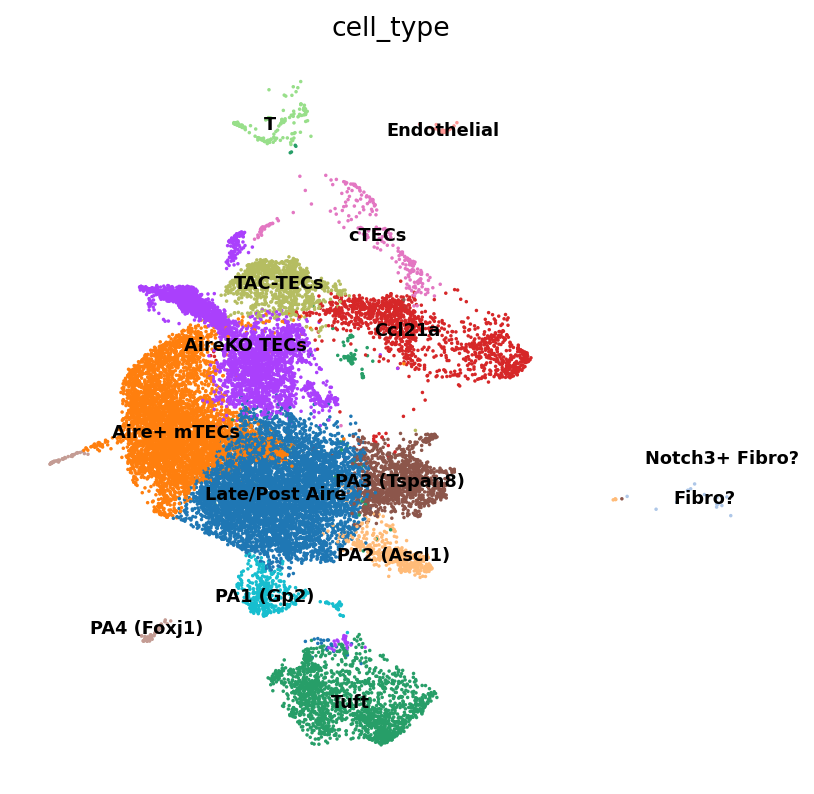

In [32]:
# gene
tmpData = adata.copy()
tmpData.obsm["X_umap"] = tmpData.obsm["gene_umap"]
sc.pl.umap(
    tmpData,
    color=["cell_type"],
    legend_loc="on data",
    s=10,
    legend_fontsize=8,
)

## All ECs with Aire

In [51]:
inv_map["Aire"]

{'31233': ['ENSMUST00000162293.7',
  'ENSMUST00000145975.7',
  'ENSMUST00000130972.7',
  'ENSMUST00000128241.7',
  'ENSMUST00000143548.7',
  'ENSMUST00000131028.7',
  'ENSMUST00000155021.7',
  'ENSMUST00000140636.7',
  'ENSMUST00000148469.7',
  'ENSMUST00000019257.14',
  'ENSMUST00000105395.8',
  'ENSMUST00000156417.7',
  'ENSMUST00000105396.8',
  'ENSMUST00000143735.7',
  'ENSMUST00000154374.1'],
 '131110': ['ENSMUST00000145975.7',
  'ENSMUST00000130972.7',
  'ENSMUST00000128241.7'],
 '131111': ['ENSMUST00000145975.7',
  'ENSMUST00000130972.7',
  'ENSMUST00000128241.7',
  'ENSMUST00000143548.7',
  'ENSMUST00000131028.7'],
 '131112': ['ENSMUST00000145975.7',
  'ENSMUST00000130972.7',
  'ENSMUST00000128241.7',
  'ENSMUST00000143548.7',
  'ENSMUST00000131028.7',
  'ENSMUST00000155021.7',
  'ENSMUST00000140636.7',
  'ENSMUST00000148469.7',
  'ENSMUST00000019257.14',
  'ENSMUST00000105395.8',
  'ENSMUST00000156417.7',
  'ENSMUST00000105396.8'],
 '131113': ['ENSMUST00000145975.7',
  'ENSMUS

In [48]:
Aire_ecs = list(inv_map["Aire"].keys())
Aire_ecs

['31233',
 '131110',
 '131111',
 '131112',
 '131113',
 '131114',
 '131115',
 '131116',
 '131117',
 '131118',
 '131119',
 '131120',
 '131121',
 '131122',
 '131123',
 '131124',
 '131125',
 '131126',
 '131127',
 '131134',
 '131153',
 '131154',
 '131158',
 '131173',
 '131174',
 '131175',
 '131176',
 '131192',
 '131269',
 '131309']

In [49]:
[ec2g[i] for i in Aire_ecs]

[['Aire', 'Grip2'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire', 'Prnp'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire'],
 ['Aire', 'Lingo4', 'Mthfs', 'Trim2', 'Uvrag'],
 ['Aire', 'Aqr', 'Fto', 'Nphs1'],
 ['Aire', 'Uvrag'],
 ['Aire'],
 ['Aire'],
 ['Aire']]

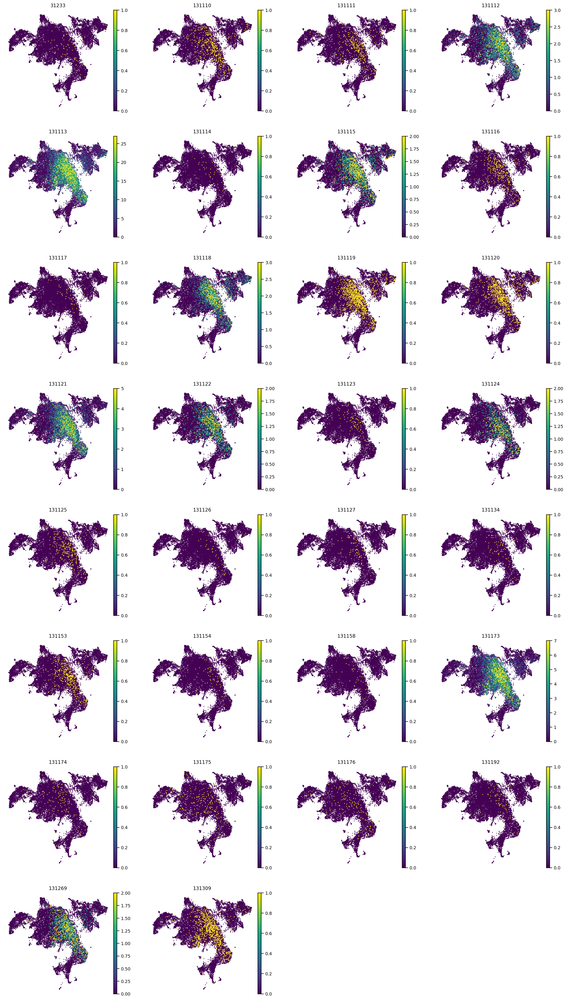

In [43]:
rna.pl.gene_umap(
    adata,
    Aire_ecs,
    layer="raw_tcc",
    s=10,
)

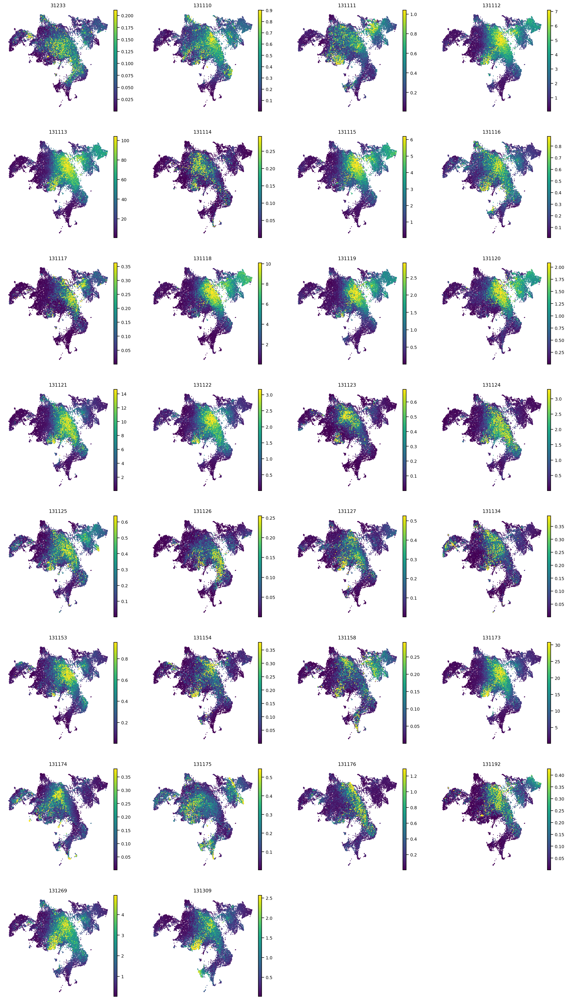

In [45]:
rna.pl.gene_umap(
    adata,
    Aire_ecs,
    layer="scvi_normalized_tcc",
    s=10,
)

## ECs with interesting Aire transcript

In [60]:
Aire_single_ecs = ["131309", "131158"]

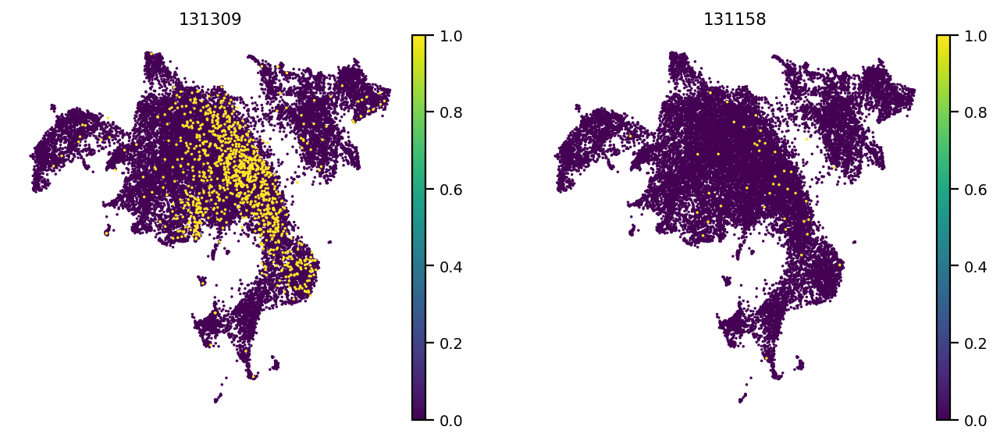

In [61]:
rna.pl.gene_umap(
    adata,
    Aire_single_ecs,
    layer="raw_tcc",
    s=10,
)

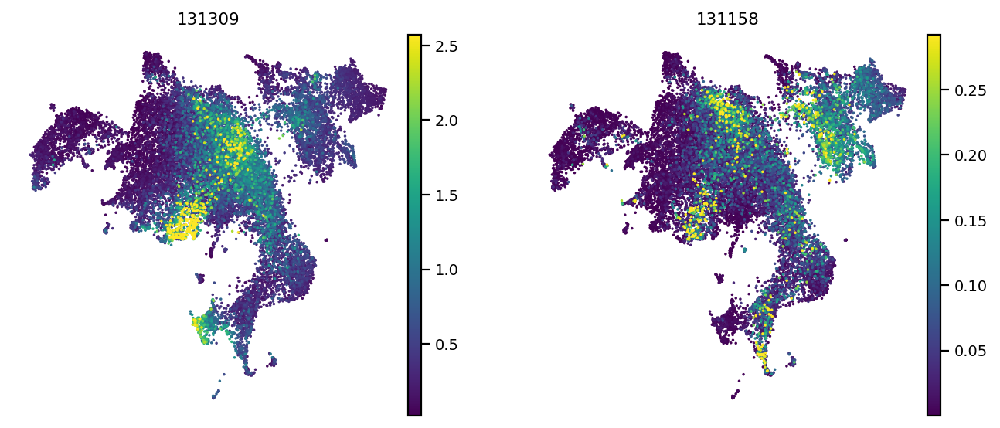

In [62]:
rna.pl.gene_umap(
    adata,
    Aire_single_ecs,
    layer="scvi_normalized_tcc",
    s=10,
)

## WT vs AireKO

### All aire ecs

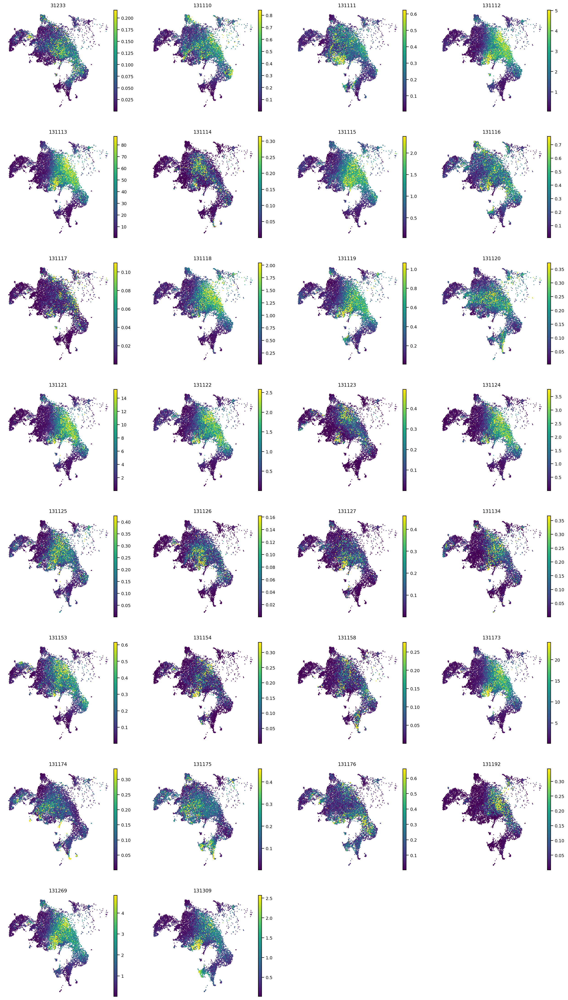

In [58]:
#WT
rna.pl.gene_umap(
    adata[adata.obs.genotype=="WT"],
    Aire_ecs,
    layer="scvi_normalized_tcc",
    s=10,
)

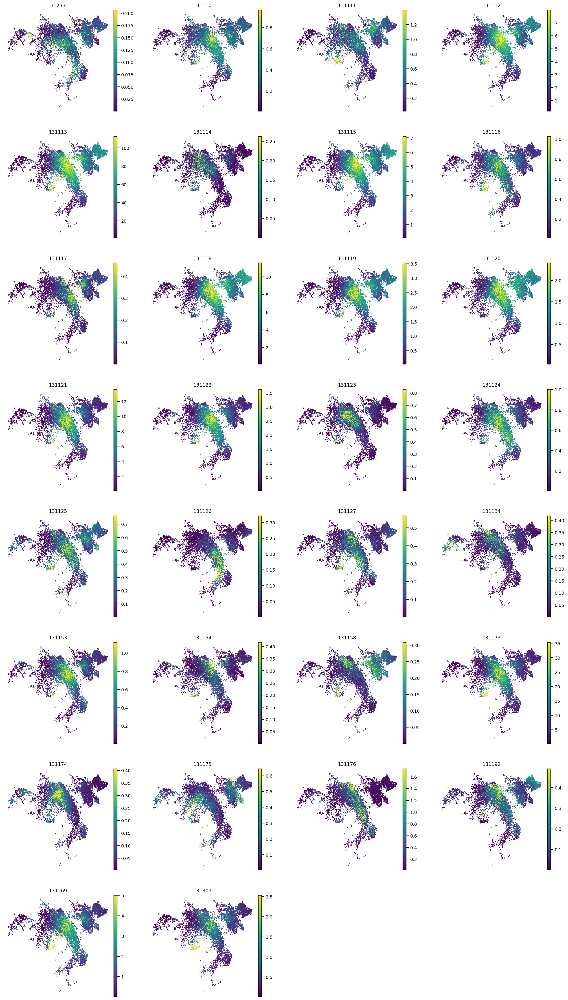

In [59]:
#AireKO
rna.pl.gene_umap(
    adata[adata.obs.genotype=="AireKO"],
    Aire_ecs,
    layer="scvi_normalized_tcc",
    s=10,
)

### interesting aire tx

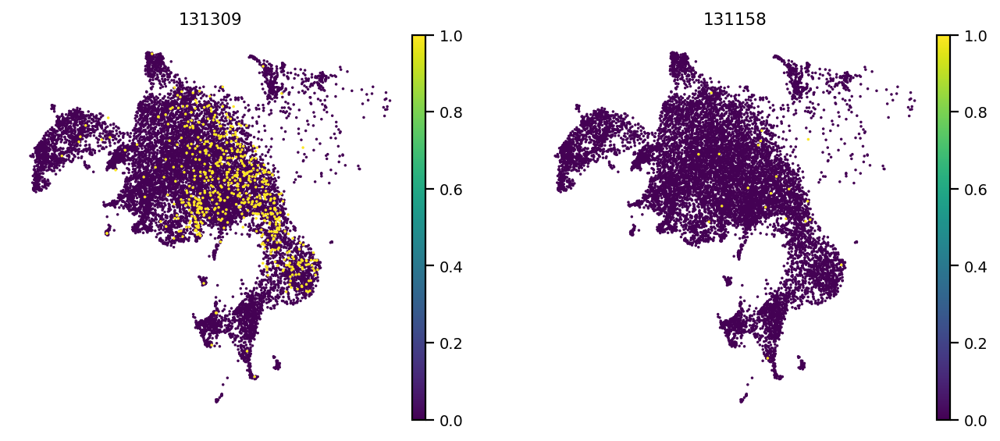

In [65]:
#WT
rna.pl.gene_umap(
    adata[adata.obs.genotype=="WT"],
    Aire_single_ecs,
    layer="raw_tcc",
    s=10,
)
# Left: retained intron, PHD, SAND; right: retained intron, no SAND

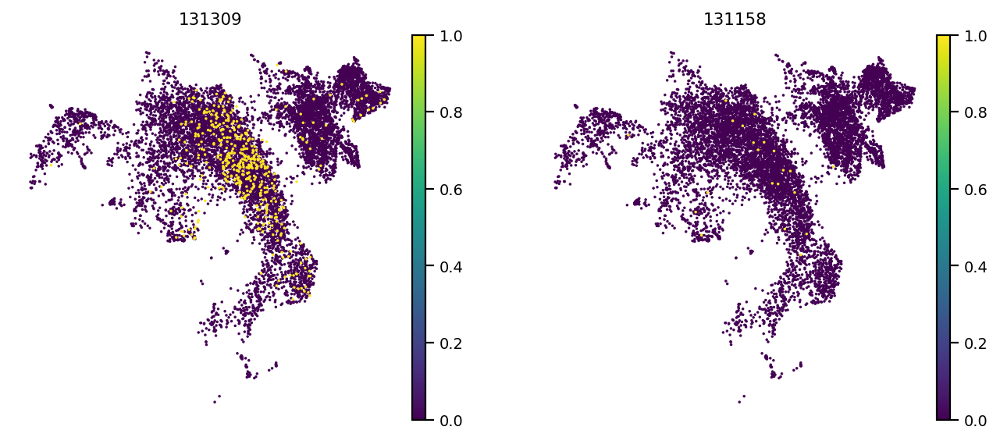

In [66]:
#AireKO
rna.pl.gene_umap(
    adata[adata.obs.genotype=="AireKO"],
    Aire_single_ecs,
    layer="raw_tcc",
    s=10,
)
# Left: retained intron, PHD, SAND; right: retained intron, no SAND

# Save anndata

In [67]:
path = "/notebook/External/Archive/Joe/processed_data/TSA_scoring/h5ad_files/WT_KO_thymus_isoforms"
adata.write(f"{path}.h5ad")